In [54]:
import os
os.environ["TF_USE_LEGACY_KERAS"] = "1"

import math
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
from tensorflow import keras
from tensorflow.keras import layers
from transformers import CLIPTokenizer, TFCLIPTextModel
import tensorflow_datasets as tfds
import string
import random
import time
import shutil

In [55]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Restrict TensorFlow to only use the first GPU
        tf.config.experimental.set_visible_devices(gpus[0], 'GPU')

        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

1 Physical GPUs, 1 Logical GPUs


In [56]:
data_path = './dataset'
df = pd.read_pickle(data_path + '/text2ImgData.pkl')
num_training_sample = len(df)
n_images_train = num_training_sample
print('There are %d image in training data' % (n_images_train))

There are 7370 image in training data


In [57]:
# Feel free t
dataset_repetitions = 1
num_epochs = 800 
image_size = 64
suffle_times = 10

# KID = Kernel Inception Distance, see related section
kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
block_depth = 2

# optimization
batch_size = 32
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

In [58]:
id2word_dict = dict(np.load('./dictionary/id2Word.npy'))

# Function to convert ids to words for one caption
def decode_caption(caption_id_list):
    return ' '.join([id2word_dict[str(id)] for id in caption_id_list if id2word_dict[str(id)] != '' and id2word_dict[str(id)] != '<PAD>' and id2word_dict[str(id)] != '<RARE>'])

# Each df['Captions'][i] is a list of 1-10 captions, each caption is a list of 20 word ids
# Decode all captions
all_captions_in_english = []
for caption_group in df['Captions']:
    english_captions = [decode_caption(caption) for caption in caption_group]
    all_captions_in_english.append(english_captions)

# Optionally: replace the captions in the dataframe
df['EnglishCaptions'] = all_captions_in_english

In [59]:
i = 0
for group in df['EnglishCaptions']:
    i += 1
    print(f'Image {i} captions:')
    for caption in group:
        print(caption)

Image 1 captions:
the petals of the flower are pink in color and have a yellow center
this flower is pink and white in color with petals that are multi colored
the purple petals have shades of white with white anther and filament
this flower has large pink petals and a white stigma in the center
this flower has petals that are pink and has a yellow stamen
a flower with short and wide petals that is light purple
this flower has small pink petals with a yellow center
this flower has large rounded pink petals with curved edges and purple veins
this flower has purple petals as well as a white stamen
Image 2 captions:
this flower has white petals and yellow pistil as its main features
this is a white flower with a yellow center and yellow anthers
the flower has petals that are pale pink and white with yellow stamen
this flower is white and pink in color with petals that have veins
this flower has very long yellow stamen and a large white petal around it
this flower has large white petals wi

In [60]:
# in this competition, you have to generate image in size 64x64x3
IMAGE_HEIGHT = 64
IMAGE_WIDTH = 64
IMAGE_CHANNEL = 3
IMAGE_SIZE_CROPPED = 48
model_name = "openai/clip-vit-base-patch32"
tokenizer = CLIPTokenizer.from_pretrained(model_name)

def training_data_generator(input_ids, image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32) 
    
    # Resize & Crop
    img.set_shape([None, None, 3])
    img = tf.image.resize(img, size=[64, 64])
    img.set_shape([64, 64, 3])
    
    # Data Augmentation
    distorted_image = tf.image.random_crop(img, [48, 48, 3])
    distorted_image = tf.image.resize(distorted_image, [64, 64])
    distorted_image = tf.image.random_flip_left_right(distorted_image)
    distorted_image = tf.image.random_brightness(distorted_image, max_delta=0.2)
    distorted_image = tf.clip_by_value(distorted_image, 0.0, 1.0)
    
    return input_ids, distorted_image

def dataset_generator(filenames, batch_size):
    df = pd.read_pickle(filenames)
    captions = df['Captions'].values
    
    sentences = []
    for i in range(len(captions)):
        temp = random.choice(captions[i])
        sentences.append(decode_caption(temp))
        
    print("Tokenizing all sentences...")
    encodings = tokenizer(
        sentences, padding="max_length", truncation=True, max_length=77, return_tensors="np"
    )
    all_input_ids = encodings['input_ids']
    image_paths = df['ImagePath'].values

    dataset = tf.data.Dataset.from_tensor_slices((all_input_ids, image_paths))
    dataset = dataset.map(training_data_generator, num_parallel_calls=tf.data.AUTOTUNE)
    
    dataset = dataset.shuffle(len(sentences)).batch(batch_size, drop_remainder=True).repeat()
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    return dataset

In [61]:
BATCH_SIZE = 64
dataset = dataset_generator(data_path + '/text2ImgData.pkl', BATCH_SIZE)

Tokenizing all sentences...


In [62]:
class ClipTextEncoder(tf.keras.Model):
    def __init__(self):
        super(ClipTextEncoder, self).__init__()
        self.encoder = TFCLIPTextModel.from_pretrained("openai/clip-vit-base-patch32")
        self.encoder.trainable = False

    def call(self, input_ids):
        return self.encoder(input_ids).pooler_output

In [63]:
# class KID(keras.metrics.Metric):
#     def __init__(self, name, **kwargs):
#         super().__init__(name=name, **kwargs)

#         # KID is estimated per batch and is averaged across batches
#         self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

#         # a pretrained InceptionV3 is used without its classification layer
#         # transform the pixel values to the 0-255 range, then use the same
#         # preprocessing as during pretraining
#         self.encoder = keras.Sequential(
#             [
#                 keras.Input(shape=(image_size, image_size, 3)),
#                 layers.Rescaling(255.0),
#                 layers.Resizing(height=kid_image_size, width=kid_image_size),
#                 layers.Lambda(keras.applications.inception_v3.preprocess_input),
#                 keras.applications.InceptionV3(
#                     include_top=False,
#                     input_shape=(kid_image_size, kid_image_size, 3),
#                     weights="imagenet",
#                 ),
#                 layers.GlobalAveragePooling2D(),
#             ],
#             name="inception_encoder",
#         )

#     def polynomial_kernel(self, features_1, features_2):
#         # Use TensorFlow functions instead of ops
#         feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype="float32")
#         return (tf.matmul(features_1, tf.transpose(features_2)) / feature_dimensions + 1.0) ** 3.0

#     def update_state(self, real_images, generated_images, sample_weight=None):
#         real_features = self.encoder(real_images, training=False)
#         generated_features = self.encoder(generated_images, training=False)

#         # compute polynomial kernels using the two sets of features
#         kernel_real = self.polynomial_kernel(real_features, real_features)
#         kernel_generated = self.polynomial_kernel(generated_features, generated_features)
#         kernel_cross = self.polynomial_kernel(real_features, generated_features)

#         # estimate the squared maximum mean discrepancy using the average kernel values
#         batch_size = tf.shape(real_features)[0]
#         batch_size_f = tf.cast(batch_size, dtype="float32")
#         mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
#             batch_size_f * (batch_size_f - 1.0)
#         )
#         mean_kernel_generated = tf.reduce_sum(kernel_generated * (1.0 - tf.eye(batch_size))) / (
#             batch_size_f * (batch_size_f - 1.0)
#         )
#         mean_kernel_cross = tf.reduce_mean(kernel_cross)
#         kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

#         # update the average KID estimate
#         self.kid_tracker.update_state(kid)

#     def result(self):
#         return self.kid_tracker.result()

#     def reset_state(self):
#         self.kid_tracker.reset_state()

In [64]:
@keras.utils.register_keras_serializable()
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.math.exp(
        tf.linspace(tf.math.log(embedding_min_frequency), tf.math.log(embedding_max_frequency), embedding_dims // 2)
    )
    angular_speeds = tf.cast(2.0 * math.pi * frequencies, "float32")
    embeddings = tf.concat([tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3)
    return embeddings

# ==========================================
# 修正後的模型定義：加入 build 方法確保權重追蹤
# ==========================================

# 1. ResidualBlock (大幅修正)
class ResidualBlock(layers.Layer):
    def __init__(self, width, **kwargs):
        super().__init__(**kwargs)
        self.width = width
        
        # 在 __init__ 預先定義所有子層 (Sub-layers)
        # 這樣 Keras 才能 100% 確保抓到變數
        self.conv_1 = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")
        self.conv_2 = layers.Conv2D(width, kernel_size=3, padding="same")
        
        # 即使可能用不到 (Identity mapping)，也先定義好，避免變數遺失警告
        self.conv_skip = layers.Conv2D(width, kernel_size=1)
        
        self.bn = layers.BatchNormalization(center=False, scale=False)
        self.add_layer = layers.Add() # 改名為 add_layer 避免跟方法名衝突

    def build(self, input_shape):
        # === 關鍵修正 ===
        # 實作這個方法來消除 "layer does not have a build() method" 警告
        super().build(input_shape)

    def call(self, x):
        input_width = x.shape[-1] # 取得輸入的 Channel 數
        
        # Skip Connection 邏輯
        if input_width == self.width:
            residual = x
        else:
            residual = self.conv_skip(x)

        # 主路徑
        y = self.bn(x)
        y = self.conv_1(y)
        y = self.conv_2(y)
        
        # 相加
        return self.add_layer([y, residual])

# 2. DownBlock (保持為函數，呼叫 Class)
def down_block(x, skips, width, block_depth):
    for _ in range(block_depth):
        x = ResidualBlock(width)(x)
        skips.append(x)
    x = layers.AveragePooling2D(pool_size=2)(x)
    return x

# 3. UpBlock (保持為函數，呼叫 Class)
def up_block(x, skips, width, block_depth):
    x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
    for _ in range(block_depth):
        x = layers.Concatenate()([x, skips.pop()])
        x = ResidualBlock(width)(x)
    return x

# 4. get_network (結構微調)
def get_network(image_size, widths, block_depth, text_embedding_dim=512):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))
    text_embeddings = keras.Input(shape=(text_embedding_dim,))

    e = layers.Lambda(sinusoidal_embedding, output_shape=(1, 1, 32))(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    t = layers.Dense(32)(text_embeddings)
    t = layers.Activation("swish")(t)
    t = layers.Reshape((1, 1, 32))(t)
    t = layers.UpSampling2D(size=image_size, interpolation="nearest")(t)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e, t])

    skips = []
    
    for width in widths[:-1]:
        x = down_block(x, skips, width, block_depth)

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = up_block(x, skips, width, block_depth)

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances, text_embeddings], x, name="residual_unet")

In [65]:

sample_sentences = [
    "the flower shown has yellow anther red pistil and bright red petals.",
    "this flower has petals that are yellow, white and purple and has dark lines",
    "the petals on this flower are white with a yellow center",
    "this flower has a lot of small round pink petals.",
    "this flower is orange in color, and has petals that are ruffled and rounded.",
    "the flower has yellow petals and the center of it is brown.",
    "this flower has petals that are blue and white.",
    "these white flowers have petals that start off white in color and end in a white towards the tips."
]


print("Tokenizing sample sentences...")
encodings = tokenizer(
    sample_sentences, 
    padding="max_length", 
    truncation=True, 
    max_length=77,
    return_tensors="tf"
)
sample_input_ids = encodings['input_ids']

print("sample_input_ids ready!")

Tokenizing sample sentences...
sample_input_ids ready!


In [66]:
# ==========================================
# 必修修正：將模型區塊改為 Class，確保權重被訓練
# ==========================================

# Embedding 函數保持不變
@keras.utils.register_keras_serializable()
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.math.exp(
        tf.linspace(tf.math.log(embedding_min_frequency), tf.math.log(embedding_max_frequency), embedding_dims // 2)
    )
    angular_speeds = tf.cast(2.0 * math.pi * frequencies, "float32")
    embeddings = tf.concat([tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3)
    return embeddings


class ResidualBlock(layers.Layer):
    def __init__(self, width, **kwargs):
        super().__init__(**kwargs)
        self.width = width
  
        self.conv_1 = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")
        self.conv_2 = layers.Conv2D(width, kernel_size=3, padding="same")
        
       
        self.conv_skip = layers.Conv2D(width, kernel_size=1)
        
        self.bn = layers.BatchNormalization(center=False, scale=False)
        self.add_layer = layers.Add() 

    def build(self, input_shape):
        
        super().build(input_shape)

    def call(self, x):
        input_width = x.shape[-1] 
        
        if input_width == self.width:
            residual = x
        else:
            residual = self.conv_skip(x)

        y = self.bn(x)
        y = self.conv_1(y)
        y = self.conv_2(y)
        
        
        return self.add_layer([y, residual])

# 2. DownBlock
def down_block(x, skips, width, block_depth):
    for _ in range(block_depth):
        x = ResidualBlock(width)(x)
        skips.append(x)
    x = layers.AveragePooling2D(pool_size=2)(x)
    return x

# 3. UpBlock
def up_block(x, skips, width, block_depth):
    x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
    for _ in range(block_depth):
        x = layers.Concatenate()([x, skips.pop()])
        x = ResidualBlock(width)(x)
    return x

# 4. get_networ
def get_network(image_size, widths, block_depth, text_embedding_dim=512):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))
    text_embeddings = keras.Input(shape=(text_embedding_dim,))

    e = layers.Lambda(sinusoidal_embedding, output_shape=(1, 1, 32))(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    t = layers.Dense(32)(text_embeddings)
    t = layers.Activation("swish")(t)
    t = layers.Reshape((1, 1, 32))(t)
    t = layers.UpSampling2D(size=image_size, interpolation="nearest")(t)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e, t])

    skips = []
    
    for width in widths[:-1]:
        x = down_block(x, skips, width, block_depth)

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = up_block(x, skips, width, block_depth)

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances, text_embeddings], x, name="residual_unet")

In [67]:
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth, text_encoder):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.text_encoder = text_encoder
        self.network = get_network(image_size, widths, block_depth)
        self.ema_network = get_network(image_size, widths, block_depth)
        self.ema_network.set_weights(self.network.get_weights())
        
    def compile(self, **kwargs):
        super().compile(**kwargs)
        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        # self.kid = KID(name="kid")

    @property
    def metrics(self):
        # return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]
        return [self.noise_loss_tracker, self.image_loss_tracker]
    
    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # TODO: check if the diffusion_times are in the range [0, 1]
        # diffusion_times should be between 0 and 1, corresponding to the start and end of the diffusion process
        diffusion_times = tf.clip_by_value(diffusion_times, 0.0, 1.0)
        
        # angles -> signal and noise rates
        # Use cosine and sine functions to calculate the signal and noise rates based on angles
        start_angle = tf.acos(max_signal_rate)
        end_angle = tf.acos(min_signal_rate)
        t_angle = (1-diffusion_times)*start_angle+diffusion_times*end_angle
        #calculate the noise and signal rates
        noise_rates = tf.sin(t_angle)
        signal_rates = tf.cos(t_angle)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, text_embeddings, training):
        # TODO: implement the denoising network
        # Use the model (self.network or self.ema_network) to predict the noise component in the images
        if training:
            network = self.network
        else:
            network = self.ema_network
        # Predict the noise component and calculate the image component using it
        # Here, use the signal_rate and noise_rate to derive the output components
        # calculate the predicted noises and images
        pred_noises = network([noisy_images, noise_rates, text_embeddings], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates
        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps, text_embeddings):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            # TODO: implement the reverse diffusion process
            # This process gradually reduces the noise to generate a clearer image
            diffusion_times = 1.0 - step * step_size
            next_diffusion_times = 1.0 - (step + 1) * step_size
            difussion_times = tf.ones((num_images, 1, 1, 1), dtype=tf.float32) * diffusion_times
            next_difussion_times = tf.ones((num_images, 1, 1, 1), dtype=tf.float32) * next_diffusion_times
            noise_rates, signal_rates = self.diffusion_schedule(difussion_times)
            next_noise_rates, next_signal_rates = self.diffusion_schedule(next_difussion_times)

            # remix the predicted components
            # Use the signal_rate and noise_rate from the next step to recombine image and noise components
            
            pred_noises, pred_images = self.denoise(next_noisy_images, noise_rates, signal_rates, text_embeddings, training=False) # network used in eval mode
            next_noisy_images = next_signal_rates * pred_images + next_noise_rates * pred_noises # remix the predicted components

        return pred_images

    def generate(self, num_images, diffusion_steps, input_ids):
        # noise -> images -> denormalized images
        text_embeddings = self.text_encoder(input_ids)
        initial_noise = tf.random.normal(
            shape=(num_images, image_size, image_size, 3)
        )
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps, text_embeddings)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, data):
        input_ids, images = data
        text_embeddings = self.text_encoder(input_ids)
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(tf.shape(images)[0], 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, text_embeddings, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    def test_step(self, data):
        input_ids, images = data
        text_embeddings = self.text_encoder(input_ids)
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(tf.shape(images)[0], image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, text_embeddings, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        # self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=2, num_cols=4):
        # plot random generated images for visual evaluation of generation quality
        test_ids = sample_input_ids[:num_rows * num_cols]
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
            input_ids=test_ids
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()

In [68]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [69]:
# save the best model based on the validation KID metric
checkpoint_path = f"checkpoints/DDIM/tf_checkpoint.weights.h5"
checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    # monitor="val_kid",
    mode="min",
    save_best_only=True,
)

Some layers from the model checkpoint at openai/clip-vit-base-patch32 were not used when initializing TFCLIPTextModel: ['clip/vision_model/encoder/layers_._1/self_attn/out_proj/kernel:0', 'clip/vision_model/encoder/layers_._5/self_attn/out_proj/kernel:0', 'clip/vision_model/encoder/layers_._9/self_attn/out_proj/bias:0', 'clip/vision_model/encoder/layers_._5/mlp/fc2/kernel:0', 'clip/vision_model/encoder/layers_._7/self_attn/k_proj/bias:0', 'clip/vision_model/encoder/layers_._3/self_attn/k_proj/kernel:0', 'clip/vision_model/encoder/layers_._5/self_attn/k_proj/bias:0', 'clip/vision_model/encoder/layers_._4/mlp/fc2/bias:0', 'clip/text_projection/kernel:0', 'clip/vision_model/encoder/layers_._11/mlp/fc1/kernel:0', 'clip/vision_model/encoder/layers_._11/self_attn/k_proj/kernel:0', 'clip/vision_model/encoder/layers_._11/self_attn/out_proj/kernel:0', 'clip/vision_model/encoder/layers_._8/self_attn/out_proj/kernel:0', 'clip/vision_model/encoder/layers_._2/self_attn/out_proj/bias:0', 'clip/visio

Tokenizing all sentences...
Adapting Normalizer...


2025-12-02 00:10:48.263227: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6150 of 7370
2025-12-02 00:10:49.815469: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


Adapt Complete.
Start training with 230 steps per epoch.
Epoch 1/800
230/230 [==============================] - ETA: 0s - n_loss: 0.2510

2025-12-02 00:12:35.187434: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6064 of 7370
2025-12-02 00:12:37.106208: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


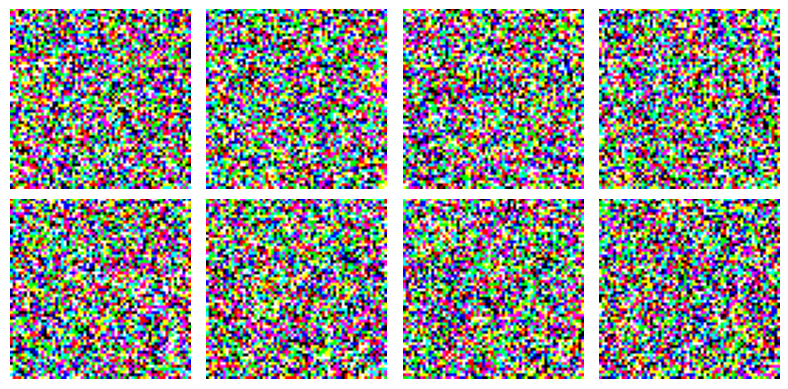

/home/yoyusamuel/hw8/.venv/lib/python3.10/site-packages/transformers/generation/tf_utils.py:465: UserWarning: `seed_generator` is deprecated and will be removed in a future version.
  warnings.warn("`seed_generator` is deprecated and will be removed in a future version.", UserWarning)


230/230 [==============================] - 117s 284ms/step - n_loss: 0.2510
Epoch 2/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1791

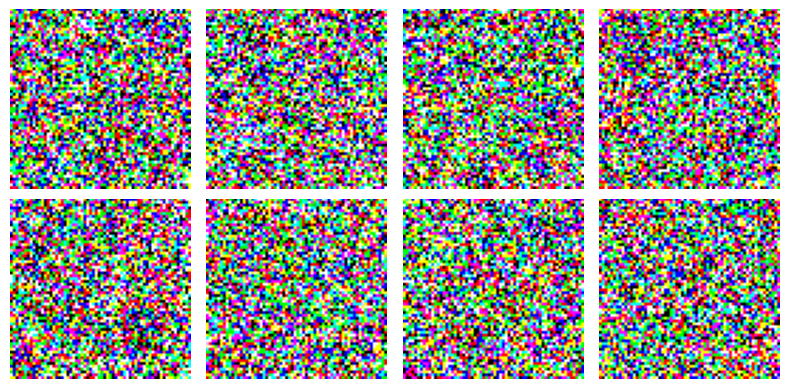

2025-12-02 00:13:40.757741: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 7213 of 7370
2025-12-02 00:13:40.948107: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 63s 275ms/step - n_loss: 0.1791
Epoch 3/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1685

2025-12-02 00:14:49.112947: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 5466 of 7370


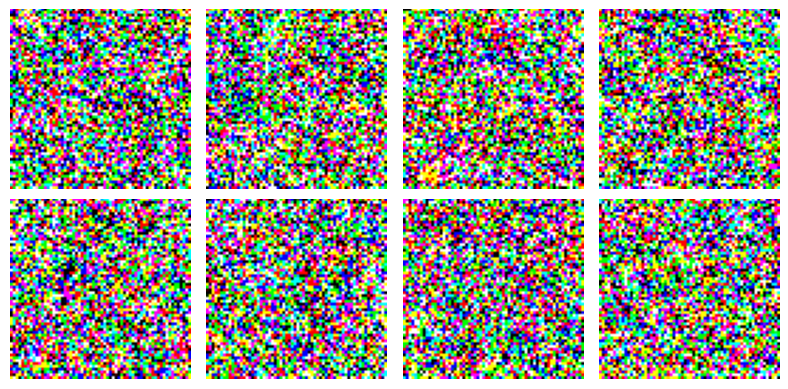

2025-12-02 00:14:52.697658: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 72s 312ms/step - n_loss: 0.1685
Epoch 4/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1631

2025-12-02 00:15:57.928911: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6182 of 7370


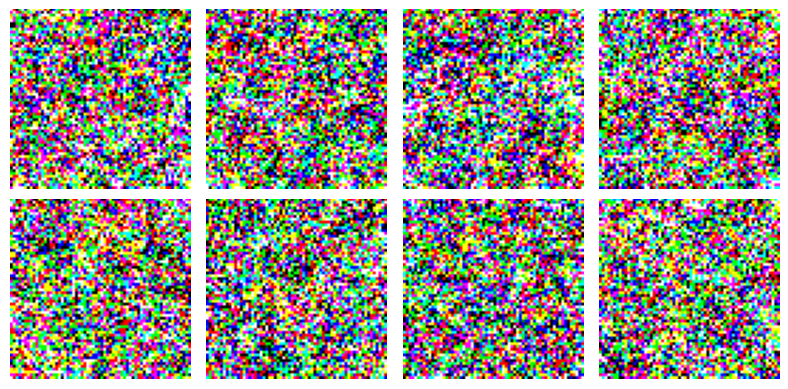

2025-12-02 00:16:00.700441: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 68s 297ms/step - n_loss: 0.1631
Epoch 5/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1578

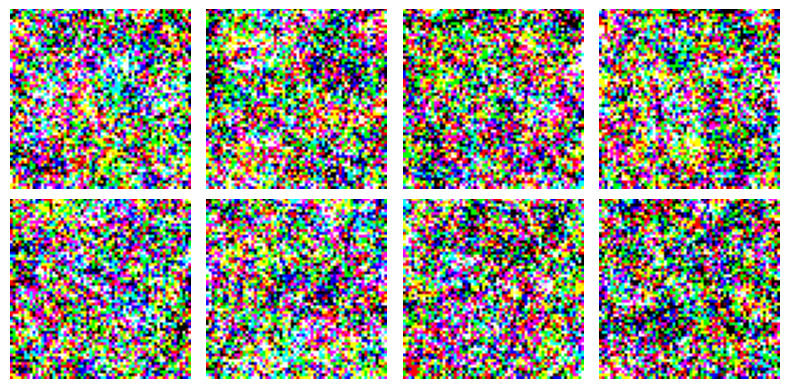

2025-12-02 00:17:02.213342: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 7074 of 7370
2025-12-02 00:17:02.656294: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 59s 255ms/step - n_loss: 0.1578
Epoch 6/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1553

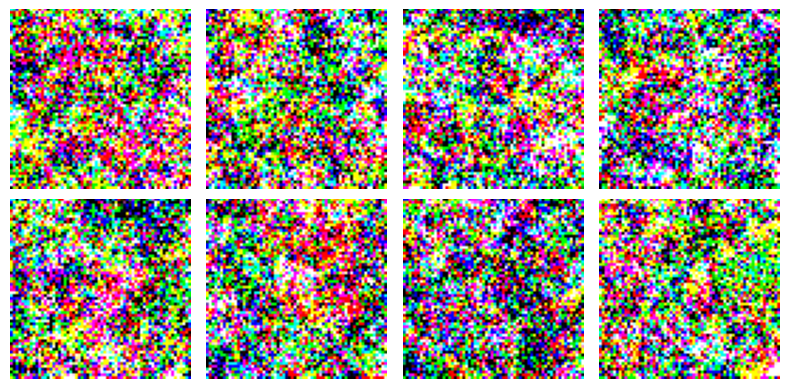

2025-12-02 00:18:01.905439: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6668 of 7370
2025-12-02 00:18:03.096492: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 61s 266ms/step - n_loss: 0.1553
Epoch 7/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1528

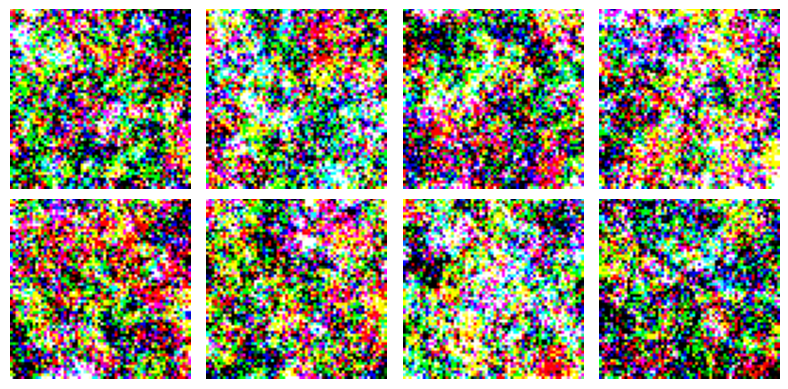

2025-12-02 00:19:15.817992: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6699 of 7370
2025-12-02 00:19:17.084306: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 74s 321ms/step - n_loss: 0.1528
Epoch 8/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1528

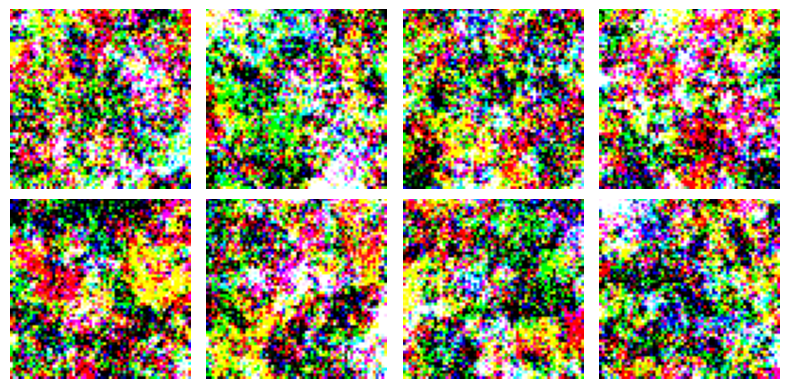

230/230 [==============================] - 55s 239ms/step - n_loss: 0.1528
Epoch 9/800


2025-12-02 00:20:22.452152: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6833 of 7370
2025-12-02 00:20:23.249551: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - ETA: 0s - n_loss: 0.1505

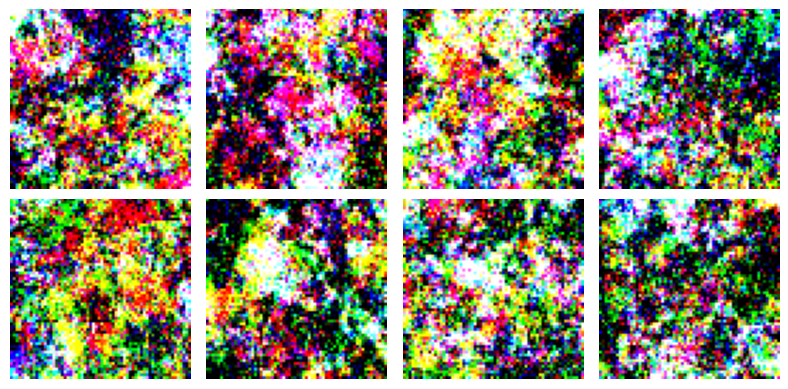

2025-12-02 00:21:14.924697: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6910 of 7370
2025-12-02 00:21:15.560815: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 63s 267ms/step - n_loss: 0.1505
Epoch 10/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1492

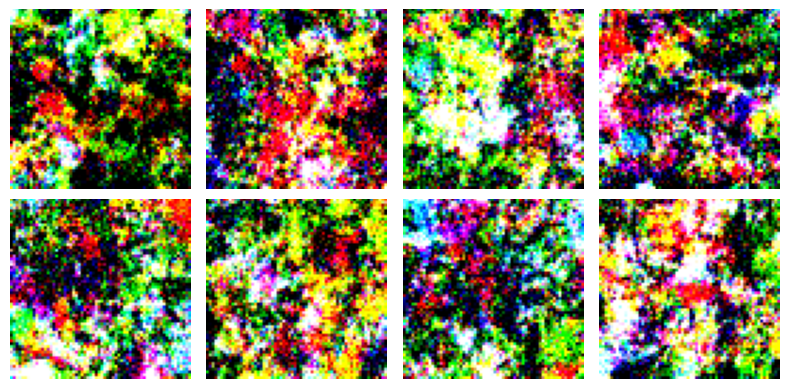

2025-12-02 00:22:16.188492: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 7228 of 7370
2025-12-02 00:22:16.376562: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 61s 264ms/step - n_loss: 0.1492
Epoch 11/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1474

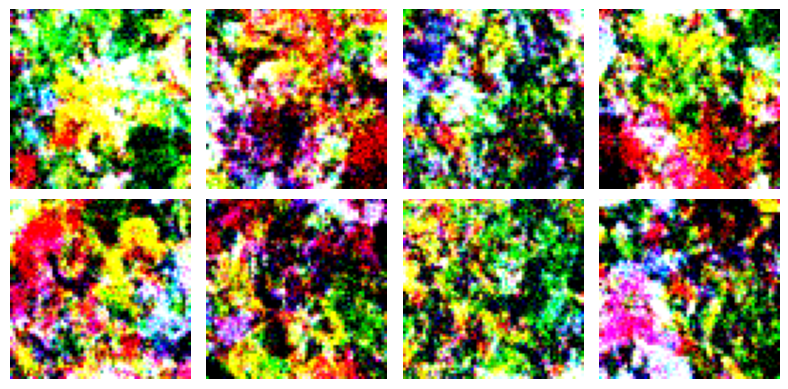

2025-12-02 00:23:17.260134: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6916 of 7370
2025-12-02 00:23:17.868545: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 60s 262ms/step - n_loss: 0.1474
Epoch 12/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1479

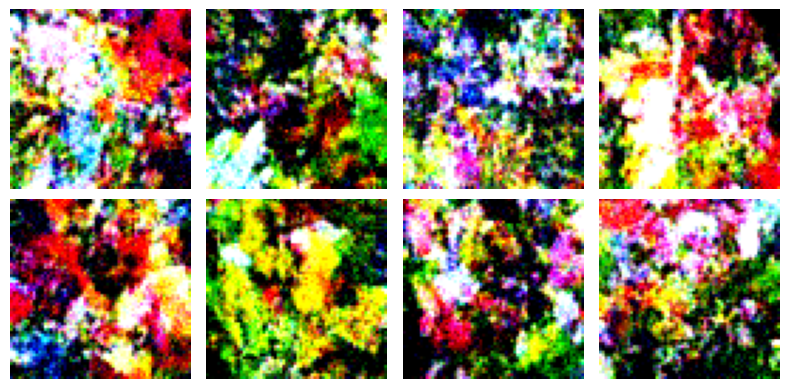

230/230 [==============================] - 55s 237ms/step - n_loss: 0.1479
Epoch 13/800


2025-12-02 00:24:21.618826: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6469 of 7370
2025-12-02 00:24:22.775725: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - ETA: 0s - n_loss: 0.1476

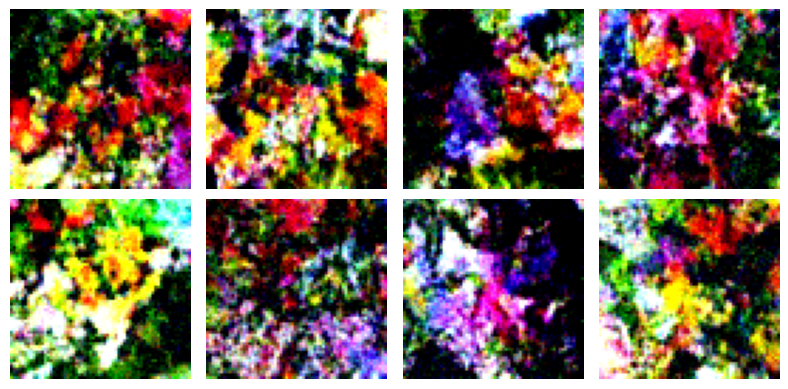

230/230 [==============================] - 51s 211ms/step - n_loss: 0.1476
Epoch 14/800


2025-12-02 00:25:11.855108: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6598 of 7370
2025-12-02 00:25:12.907738: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - ETA: 0s - n_loss: 0.1455

2025-12-02 00:26:05.361732: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6818 of 7370


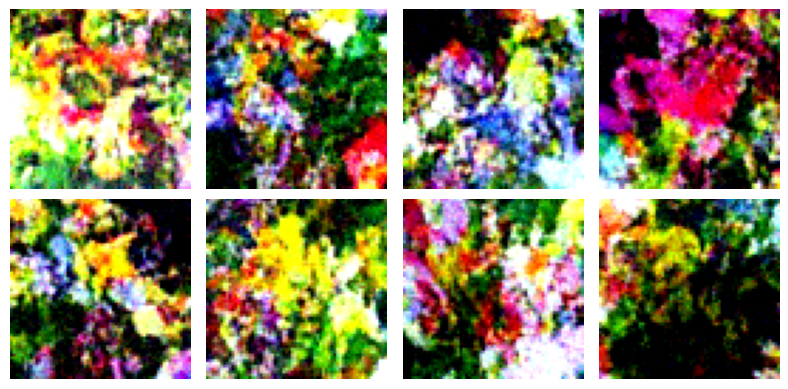

2025-12-02 00:26:06.097839: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - 65s 278ms/step - n_loss: 0.1455
Epoch 15/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1463

2025-12-02 00:27:09.478365: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6379 of 7370


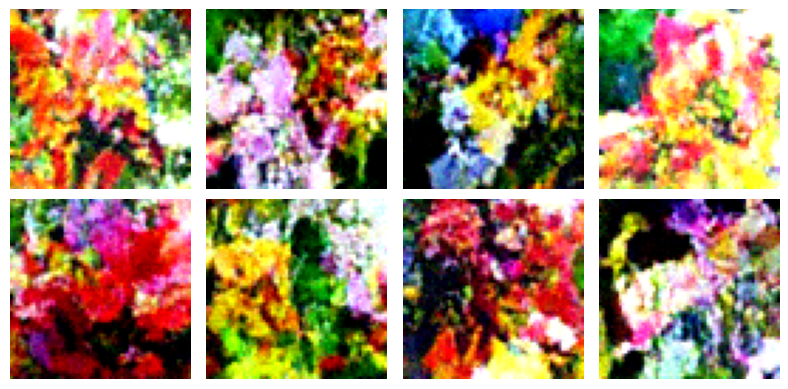

230/230 [==============================] - 55s 236ms/step - n_loss: 0.1463
Epoch 16/800


2025-12-02 00:27:11.663858: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


230/230 [==============================] - ETA: 0s - n_loss: 0.1448

2025-12-02 00:28:07.504132: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6380 of 7370
2025-12-02 00:28:08.880272: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


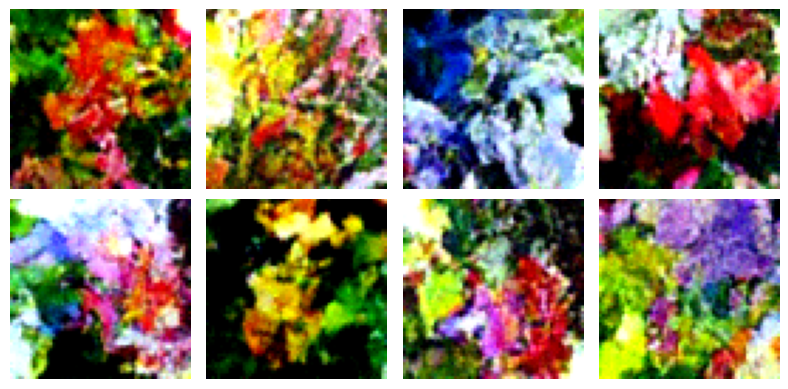

230/230 [==============================] - 68s 296ms/step - n_loss: 0.1448
Epoch 17/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1446

2025-12-02 00:29:13.639541: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6929 of 7370
2025-12-02 00:29:14.249879: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


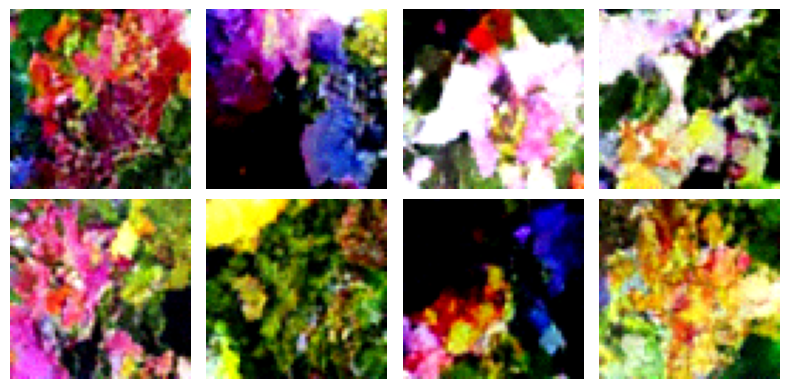

230/230 [==============================] - 67s 291ms/step - n_loss: 0.1446
Epoch 18/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1435

2025-12-02 00:30:19.202988: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 5236 of 7370
2025-12-02 00:30:22.240951: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


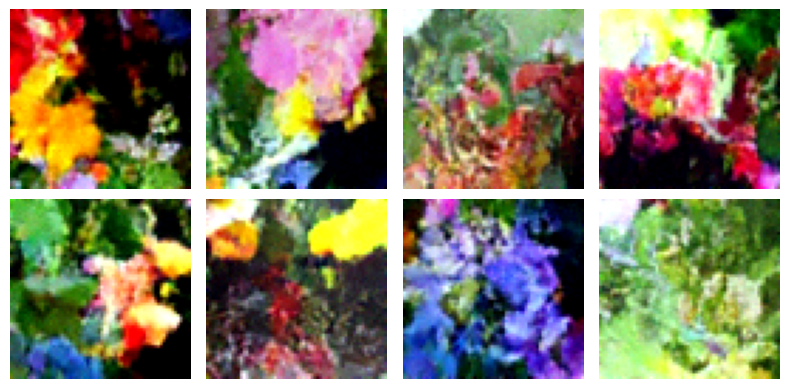

230/230 [==============================] - 66s 287ms/step - n_loss: 0.1435
Epoch 19/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1450

2025-12-02 00:31:25.059010: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6881 of 7370
2025-12-02 00:31:25.793196: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


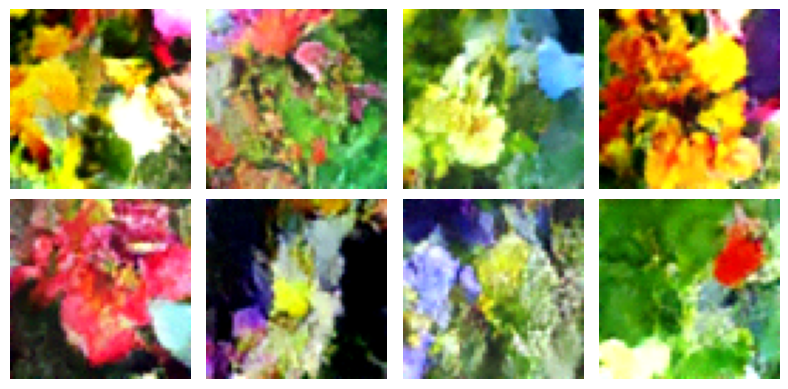

230/230 [==============================] - 54s 235ms/step - n_loss: 0.1450
Epoch 20/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1432

2025-12-02 00:32:18.876480: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6984 of 7370
2025-12-02 00:32:19.445003: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


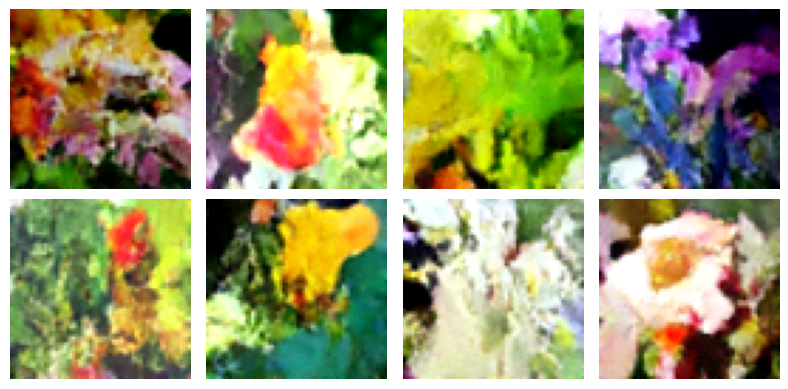

230/230 [==============================] - 63s 274ms/step - n_loss: 0.1432
Epoch 21/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1430

2025-12-02 00:33:17.559477: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 7028 of 7370
2025-12-02 00:33:18.642906: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


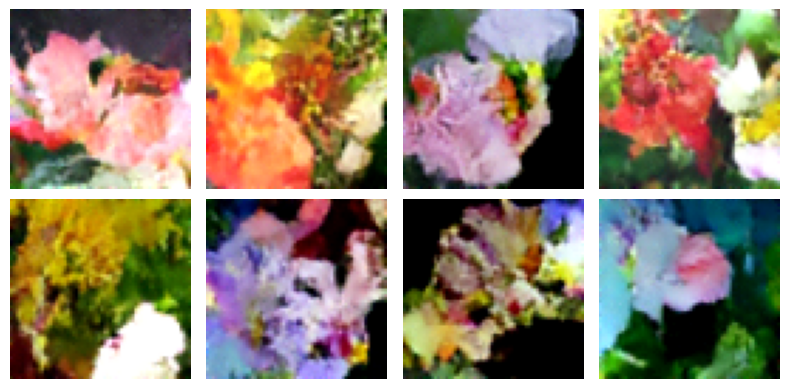

230/230 [==============================] - 60s 258ms/step - n_loss: 0.1430
Epoch 22/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1417

2025-12-02 00:34:22.660261: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6397 of 7370
2025-12-02 00:34:24.166723: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


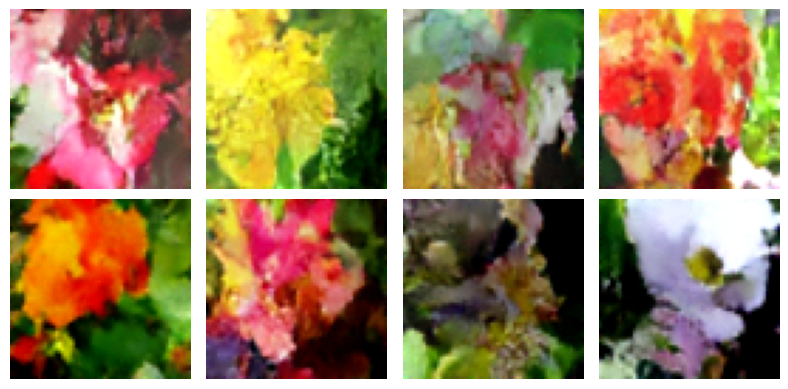

230/230 [==============================] - 65s 280ms/step - n_loss: 0.1417
Epoch 23/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1420

2025-12-02 00:35:26.378021: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 6403 of 7370
2025-12-02 00:35:27.774104: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


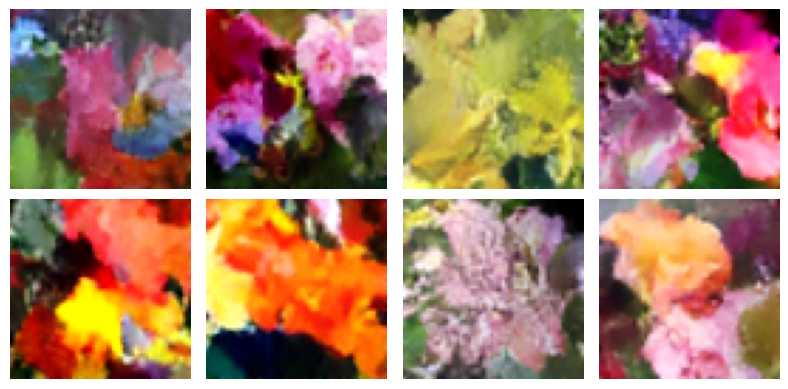

230/230 [==============================] - 55s 236ms/step - n_loss: 0.1420
Epoch 24/800
230/230 [==============================] - ETA: 0s - n_loss: 0.1429

2025-12-02 00:36:22.375291: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] ShuffleDatasetV3:64: Filling up shuffle buffer (this may take a while): 4417 of 7370
2025-12-02 00:36:29.575938: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:482] Shuffle buffer filled.


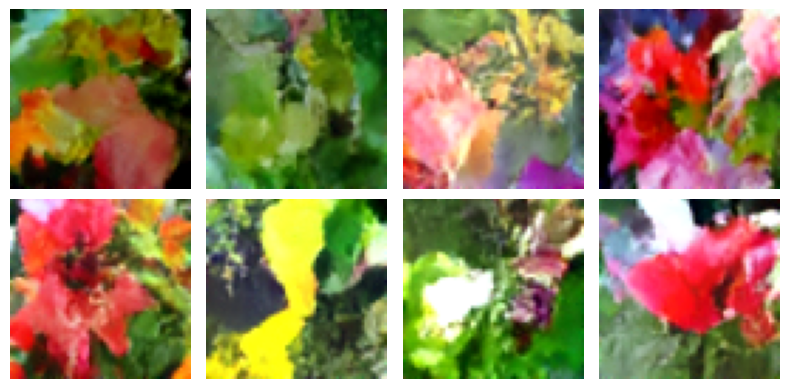

230/230 [==============================] - 61s 266ms/step - n_loss: 0.1429
Epoch 25/800
105/230 [============>.................] - ETA: 30s - n_loss: 0.1417

KeyboardInterrupt: 

In [70]:

sample_sentences = [
    "the flower shown has yellow anther red pistil and bright red petals.",
    "this flower has petals that are yellow, white and purple and has dark lines",
    "the petals on this flower are white with a yellow center",
    "this flower has a lot of small round pink petals.",
    "this flower is orange in color, and has petals that are ruffled and rounded.",
    "the flower has yellow petals and the center of it is brown.",
    "this flower has petals that are blue and white.",
    "these white flowers have petals that start off white in color and end in a white towards the tips."
]
encodings = tokenizer(sample_sentences, padding="max_length", truncation=True, max_length=77, return_tensors="tf")
sample_input_ids = encodings['input_ids']

text_encoder = ClipTextEncoder()
model = DiffusionModel(image_size, widths, block_depth, text_encoder)
model.compile(
    optimizer=tf.keras.optimizers.AdamW(learning_rate=learning_rate, weight_decay=weight_decay),
    loss=tf.keras.losses.MeanAbsoluteError(),
)

train_dataset = dataset_generator(data_path + '/text2ImgData.pkl', batch_size)

total_samples = len(pd.read_pickle(data_path + '/text2ImgData.pkl'))
steps_per_epoch = total_samples // batch_size
image_ds = train_dataset.map(lambda text, img: img)
image_ds = image_ds.take(steps_per_epoch)
print("Adapting Normalizer...")
model.normalizer.adapt(image_ds)
print("Adapt Complete.")

checkpoint_path = "checkpoints/DDIM/tf_checkpoint.weights.h5"
checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="n_loss",
    mode="min",
    save_best_only=True,
)

print(f"Start training with {steps_per_epoch} steps per epoch.")
model.fit(
    train_dataset,
    epochs=num_epochs,
    steps_per_epoch=steps_per_epoch,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback
    ],
)

In [ ]:

def testing_data_generator(caption, index):
    return caption, index

def testing_dataset_generator(batch_size):
    data = pd.read_pickle('./dataset/testData.pkl')
    captions = data['Captions'].values
    sentences = []
    for i in range(len(captions)):
        sentences.append(decode_caption(captions[i]))
    
    captions_np = np.asarray(sentences)
    index_np = np.asarray(data['ID'].values)

    dataset = tf.data.Dataset.from_tensor_slices((captions_np, index_np))
    dataset = dataset.map(testing_data_generator)
    dataset = dataset.batch(batch_size, drop_remainder=False)
    return dataset

testing_dataset = testing_dataset_generator(batch_size)

if not os.path.exists('./inference/demo'):
    os.makedirs('./inference/demo')

if os.path.exists(checkpoint_path):
    model.load_weights(checkpoint_path)
    print("Loaded weights.")

def inference(dataset):
    print("Starting Inference...")
    start = time.time()

    for batch_captions, batch_indices in dataset:
        current_batch_size = tf.shape(batch_captions)[0]
        
        batch_captions_list = [c.decode('utf-8') for c in batch_captions.numpy()]
        
        encodings = tokenizer(
            batch_captions_list, padding="max_length", truncation=True, max_length=77, return_tensors="tf"
        )
        batch_input_ids = encodings['input_ids']
        
        generated_images = model.generate(
            num_images=current_batch_size,
            diffusion_steps=50,
            input_ids=batch_input_ids
        )

        for i in range(current_batch_size):
            image_id = batch_indices[i].numpy()
            img = generated_images[i].numpy()
            
            img = np.clip(img * 255, 0, 255).astype(np.uint8)
            
            save_path = './inference/demo/inference_{:04d}.jpg'.format(image_id)
            plt.imsave(save_path, img)

        print(f"Saved up to ID {batch_indices[-1]}")

    print('Time for inference is {:.4f} sec'.format(time.time()-start))


inference(testing_dataset) # 訓練完再打開